In [305]:
import sys
sys.path.append('/Applications/anaconda3/lib/python3.8/site-packages/')

from sklearn import datasets
from sklearn.model_selection import train_test_split

import tensorflow as tf
import keras
import numpy as np
import matplotlib.pyplot as plt
import os
import SimpleITK as sitk
# import nibabel
import math
# import texture

from keras.utils.np_utils import to_categorical
from keras import optimizers 
from keras.models import Sequential, Model
from keras.layers import Dense, Activation, Flatten, Conv2D, MaxPooling2D, Dropout, Input, Lambda, Reshape, AveragePooling2D, BatchNormalization
from keras.layers.merge import add, concatenate
from keras.applications.resnet50 import ResNet50, decode_predictions

from keras import backend as K
from keras.utils import plot_model

from keras.callbacks import EarlyStopping, LambdaCallback, ModelCheckpoint 
from keras import optimizers
from keras.preprocessing.image import ImageDataGenerator
from keras.layers.normalization import BatchNormalization

from keras_unet.utils import plot_imgs, get_augmented, plot_segm_history
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance 
from keras_unet.models import custom_unet

os.environ["KERAS_BACKEND"] = "plaidml.keras.backend"

In [306]:
import tensorflow as tf
print(tf.__version__)
tf.config.list_physical_devices('GPU')
from tensorflow.python.client import device_lib
physical_devices = tf.config.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], enable=True)

2.2.0


IndexError: list index out of range

In [307]:
import os
from keras_unet.metrics import iou, iou_thresholded

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0,1"
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

physical_devices = tf.config.experimental.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], True)
tf.config.set_visible_devices(physical_devices[0:1], 'GPU')

IndexError: list index out of range

In [308]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/T1NORM_RESAMPLE_HC/Train/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [309]:
# feature for deep learning (3D): img

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/T1NORM_RESAMPLE_HC/Train/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
feature = sitk.GetArrayFromImage(first)

feature_reshape = feature.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    feature_reshape = np.dstack((feature_reshape, j_reshape))

In [310]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_HC/Train/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [311]:
# feature for deep learning (3D): mask

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_HC/Train/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
mask = sitk.GetArrayFromImage(first)

mask_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    mask_reshape = np.dstack((mask_reshape, j_reshape))

In [312]:
# Extract slices with masks identified from a training set 

mask_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))
feature_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))

for n in range(feature_reshape.shape[2]):

    mask_slice = mask_reshape[:,:,n]
    feature_slice = feature_reshape[:,:,n]
    
    if (len(np.unique(mask_slice)) > 1): # only if mask is identified by a radiologist 
        
        mask_valid = np.dstack((mask_valid, mask_slice))
        feature_valid = np.dstack((feature_valid, feature_slice))
        
mask_valid = mask_valid[:,:,1:]
feature_valid = feature_valid[:,:,1:]

print(mask_valid.shape)
print(feature_valid.shape)

(528, 528, 192)
(528, 528, 192)


In [313]:
feature = feature_valid
feature.shape
maxval = np.amax(feature)
feature_norm = feature/maxval
feature_temp = feature_norm.transpose(2,0,1)
feature_final = feature_temp.reshape((feature_temp.shape[0],feature_temp.shape[1],feature_temp.shape[2],1))
feature_final.shape

mask = mask_valid
mask_final = mask.transpose(2,0,1)
mask_final = mask_final.reshape((mask_final.shape[0],mask_final.shape[1],mask_final.shape[2],1))

In [314]:
X_train = feature_final
y_train = mask_final 

In [315]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/T1NORM_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [316]:
# feature for deep learning (3D): img

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/T1NORM_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
feature = sitk.GetArrayFromImage(first)

feature_reshape = feature.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    feature_reshape = np.dstack((feature_reshape, j_reshape))

In [317]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [318]:
# feature for deep learning (3D): mask

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
mask = sitk.GetArrayFromImage(first)

mask_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    mask_reshape = np.dstack((mask_reshape, j_reshape))

In [319]:
# Extract slices with masks identified from a test set 

mask_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))
feature_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))

for n in range(feature_reshape.shape[2]):

    mask_slice = mask_reshape[:,:,n]
    feature_slice = feature_reshape[:,:,n]
    
    if (len(np.unique(mask_slice)) > 1): # only if mask is identified by a radiologist 
        
        mask_valid = np.dstack((mask_valid, mask_slice))
        feature_valid = np.dstack((feature_valid, feature_slice))
        
mask_valid = mask_valid[:,:,1:]
feature_valid = feature_valid[:,:,1:]

print(mask_valid.shape)
print(feature_valid.shape)

(528, 528, 187)
(528, 528, 187)


In [320]:
feature = feature_valid
feature.shape
maxval = np.amax(feature)
feature_norm = feature/maxval
feature_temp = feature_norm.transpose(2,0,1)
feature_final = feature_temp.reshape((feature_temp.shape[0],feature_temp.shape[1],feature_temp.shape[2],1))
feature_final.shape

mask = mask_valid
mask_final = mask.transpose(2,0,1)
mask_final = mask_final.reshape((mask_final.shape[0],mask_final.shape[1],mask_final.shape[2],1))

In [321]:
X_test = feature_final
y_test = mask_final 

In [322]:
train_gen = get_augmented(X_train, y_train, batch_size = 32, data_gen_args = dict(rotation_range = 5., width_shift_range = 0.05, height_shift_range = 0.05, shear_range = 40, zoom_range = 0.2, horizontal_flip = True, vertical_flip = True, fill_mode = 'constant'))
sample_batch = next(train_gen)
xx, yy = sample_batch
input_shape = X_train[0].shape

model = custom_unet(input_shape, filters = 32, use_batch_norm = True, dropout = 0.3, dropout_change_per_layer = 0.0, num_layers = 4)
model.summary()

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 528, 528, 1) 0                                            
__________________________________________________________________________________________________
conv2d_114 (Conv2D)             (None, 528, 528, 32) 288         input_7[0][0]                    
__________________________________________________________________________________________________
batch_normalization_108 (BatchN (None, 528, 528, 32) 128         conv2d_114[0][0]                 
__________________________________________________________________________________________________
spatial_dropout2d_30 (SpatialDr (None, 528, 528, 32) 0           batch_normalization_108[0][0]    
____________________________________________________________________________________________

In [323]:
batch_size = 32
model_filename = '2d_unet_BM_HC.h5'
# es = EarlyStopping(monitor = 'val_loss', mode = 'min', verbose = 1)
callback_checkpoint = ModelCheckpoint(model_filename, verbose = 1, monitor = 'val_loss', save_best_only = True)
model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = [iou, iou_thresholded])

In [324]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(192, 528, 528, 1)
(192, 528, 528, 1)
(187, 528, 528, 1)
(187, 528, 528, 1)


In [325]:
history = model.fit_generator(train_gen, steps_per_epoch = len(y_train)//batch_size, epochs = 100, validation_data = (X_test, y_test), callbacks = [callback_checkpoint])

Epoch 1/100
6/6 [==============================] - ETA: 0s - loss: 0.7801 - iou: 0.0866 - iou_thresholded: 0.1084 
Epoch 00001: val_loss improved from inf to 0.67244, saving model to 2d_unet_BM_HC.h5
6/6 [==============================] - 182s 30s/step - loss: 0.7801 - iou: 0.0866 - iou_thresholded: 0.1084 - val_loss: 0.6724 - val_iou: 0.0656 - val_iou_thresholded: 0.1298
Epoch 2/100
6/6 [==============================] - ETA: 0s - loss: 0.6724 - iou: 0.0927 - iou_thresholded: 0.1503 
Epoch 00002: val_loss improved from 0.67244 to 0.53488, saving model to 2d_unet_BM_HC.h5
6/6 [==============================] - 187s 31s/step - loss: 0.6724 - iou: 0.0927 - iou_thresholded: 0.1503 - val_loss: 0.5349 - val_iou: 0.0247 - val_iou_thresholded: 0.0321
Epoch 3/100
6/6 [==============================] - ETA: 0s - loss: 0.6222 - iou: 0.0992 - iou_thresholded: 0.1989 
Epoch 00003: val_loss did not improve from 0.53488
6/6 [==============================] - 189s 31s/step - loss: 0.6222 - iou: 0.099

6/6 [==============================] - ETA: 0s - loss: 0.0925 - iou: 0.4814 - iou_thresholded: 0.8466 
Epoch 00024: val_loss did not improve from 0.27569
6/6 [==============================] - 187s 31s/step - loss: 0.0925 - iou: 0.4814 - iou_thresholded: 0.8466 - val_loss: 0.3025 - val_iou: 0.0142 - val_iou_thresholded: 1.6668e-06
Epoch 25/100
6/6 [==============================] - ETA: 0s - loss: 0.0857 - iou: 0.5037 - iou_thresholded: 0.8485 
Epoch 00025: val_loss did not improve from 0.27569
6/6 [==============================] - 187s 31s/step - loss: 0.0857 - iou: 0.5037 - iou_thresholded: 0.8485 - val_loss: 0.3296 - val_iou: 0.0089 - val_iou_thresholded: 1.6718e-06
Epoch 26/100
6/6 [==============================] - ETA: 0s - loss: 0.0772 - iou: 0.5400 - iou_thresholded: 0.8548 
Epoch 00026: val_loss did not improve from 0.27569
6/6 [==============================] - 188s 31s/step - loss: 0.0772 - iou: 0.5400 - iou_thresholded: 0.8548 - val_loss: 0.3434 - val_iou: 0.0073 - val_iou

Epoch 48/100
6/6 [==============================] - ETA: 0s - loss: 0.0397 - iou: 0.7134 - iou_thresholded: 0.8839 
Epoch 00048: val_loss did not improve from 0.27569
6/6 [==============================] - 188s 31s/step - loss: 0.0397 - iou: 0.7134 - iou_thresholded: 0.8839 - val_loss: 0.2815 - val_iou: 0.1294 - val_iou_thresholded: 0.1252
Epoch 49/100
6/6 [==============================] - ETA: 0s - loss: 0.0384 - iou: 0.7300 - iou_thresholded: 0.8871 
Epoch 00049: val_loss improved from 0.27569 to 0.26036, saving model to 2d_unet_BM_HC.h5
6/6 [==============================] - 189s 31s/step - loss: 0.0384 - iou: 0.7300 - iou_thresholded: 0.8871 - val_loss: 0.2604 - val_iou: 0.1139 - val_iou_thresholded: 0.1054
Epoch 50/100
6/6 [==============================] - ETA: 0s - loss: 0.0367 - iou: 0.7397 - iou_thresholded: 0.8848 
Epoch 00050: val_loss did not improve from 0.26036
6/6 [==============================] - 188s 31s/step - loss: 0.0367 - iou: 0.7397 - iou_thresholded: 0.8848 - v

6/6 [==============================] - ETA: 0s - loss: 0.0297 - iou: 0.7836 - iou_thresholded: 0.8899 
Epoch 00071: val_loss improved from 0.11893 to 0.10431, saving model to 2d_unet_BM_HC.h5
6/6 [==============================] - 187s 31s/step - loss: 0.0297 - iou: 0.7836 - iou_thresholded: 0.8899 - val_loss: 0.1043 - val_iou: 0.5349 - val_iou_thresholded: 0.5276
Epoch 72/100
6/6 [==============================] - ETA: 0s - loss: 0.0275 - iou: 0.7969 - iou_thresholded: 0.8973 
Epoch 00072: val_loss improved from 0.10431 to 0.08642, saving model to 2d_unet_BM_HC.h5
6/6 [==============================] - 187s 31s/step - loss: 0.0275 - iou: 0.7969 - iou_thresholded: 0.8973 - val_loss: 0.0864 - val_iou: 0.5763 - val_iou_thresholded: 0.5881
Epoch 73/100
6/6 [==============================] - ETA: 0s - loss: 0.0290 - iou: 0.7932 - iou_thresholded: 0.8881 
Epoch 00073: val_loss improved from 0.08642 to 0.08008, saving model to 2d_unet_BM_HC.h5
6/6 [==============================] - 187s 31s/

Epoch 94/100
6/6 [==============================] - ETA: 0s - loss: 0.0226 - iou: 0.8304 - iou_thresholded: 0.9028 
Epoch 00094: val_loss did not improve from 0.03330
6/6 [==============================] - 187s 31s/step - loss: 0.0226 - iou: 0.8304 - iou_thresholded: 0.9028 - val_loss: 0.0339 - val_iou: 0.7626 - val_iou_thresholded: 0.8144
Epoch 95/100
6/6 [==============================] - ETA: 0s - loss: 0.0223 - iou: 0.8307 - iou_thresholded: 0.9047 
Epoch 00095: val_loss did not improve from 0.03330
6/6 [==============================] - 188s 31s/step - loss: 0.0223 - iou: 0.8307 - iou_thresholded: 0.9047 - val_loss: 0.0387 - val_iou: 0.7221 - val_iou_thresholded: 0.7639
Epoch 96/100
6/6 [==============================] - ETA: 0s - loss: 0.0219 - iou: 0.8359 - iou_thresholded: 0.9079 
Epoch 00096: val_loss did not improve from 0.03330
6/6 [==============================] - 187s 31s/step - loss: 0.0219 - iou: 0.8359 - iou_thresholded: 0.9079 - val_loss: 0.0346 - val_iou: 0.7439 - va

In [326]:
model.save('/Applications/anaconda3/envs/myenv/mywork/unet/')

INFO:tensorflow:Assets written to: /Applications/anaconda3/envs/myenv/mywork/unet/assets


In [327]:
from keras.models import load_model

model.save(model_filename)

dependencies = {
    
    'iou': iou,
    'iou_thresholded': iou_thresholded
}

model = keras.models.load_model(model_filename, custom_objects = dependencies)

In [328]:
model_json = model.to_json()

with open("2d_unet_BM_HC.json","w") as json_file:
    json_file.write(model_json)
    
model.save_weights(model_filename)
model.load_weights(model_filename)
y_pred = model.predict(X_test)

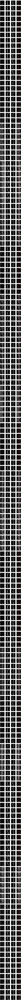

In [329]:
plot_imgs(org_imgs=X_test, mask_imgs=y_test, pred_imgs=y_pred, nm_img_to_plot=187)

In [303]:
def dice_coef2(y_test, y_pred):
    
    y_test_f = y_test.flatten()
    y_pred_f = y_pred.flatten()
    union = np.sum(y_test_f) + np.sum(y_pred_f)
    if union == 0: return 1
    intersection = np.sum(y_test_f * y_pred_f)
    return 2. * intersection / union

In [304]:
dsc = dice_coef2(y_test, y_pred)
print(dsc)

0.887696367943326


In [259]:
X_test.shape
y_pred.shape

(235, 528, 528, 1)

In [260]:
# Copyright (C) 2013 Oskar Maier
# 
# This program is free software: you can redistribute it and/or modify
# it under the terms of the GNU General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
# 
# This program is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.  See the
# GNU General Public License for more details.
# 
# You should have received a copy of the GNU General Public License
# along with this program.  If not, see <http://www.gnu.org/licenses/>.
#
# author Oskar Maier
# version r0.1.1
# since 2014-03-13
# status Release

# build-in modules

# third-party modules

import numpy
from scipy.ndimage import _ni_support
from scipy.ndimage.morphology import distance_transform_edt, binary_erosion,\
    generate_binary_structure
from scipy.ndimage.measurements import label, find_objects
from scipy.stats import pearsonr

# own modules

# code
def dc(result, reference):
 
    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
    
    intersection = numpy.count_nonzero(result & reference)
    
    size_i1 = numpy.count_nonzero(result)
    size_i2 = numpy.count_nonzero(reference)
    
    try:
        dc = 2. * intersection / float(size_i1 + size_i2)
    except ZeroDivisionError:
        dc = 0.0
    
    return dc


def jc(result, reference):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
    
    intersection = numpy.count_nonzero(result & reference)
    union = numpy.count_nonzero(result | reference)
    
    jc = float(intersection) / float(union)
    
    return jc


def precision(result, reference):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
        
    tp = numpy.count_nonzero(result & reference)
    fp = numpy.count_nonzero(result & ~reference)
    
    try:
        precision = tp / float(tp + fp)
    except ZeroDivisionError:
        precision = 0.0
    
    return precision


def recall(result, reference):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
        
    tp = numpy.count_nonzero(result & reference)
    fn = numpy.count_nonzero(~result & reference)

    try:
        recall = tp / float(tp + fn)
    except ZeroDivisionError:
        recall = 0.0
    
    return recall


def sensitivity(result, reference):
    
    return recall(result, reference)


def specificity(result, reference):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
       
    tn = numpy.count_nonzero(~result & ~reference)
    fp = numpy.count_nonzero(result & ~reference)

    try:
        specificity = tn / float(tn + fp)
    except ZeroDivisionError:
        specificity = 0.0
    
    return specificity


def true_negative_rate(result, reference):
    
    return specificity(result, reference)


def true_positive_rate(result, reference):

    return recall(result, reference)


def positive_predictive_value(result, reference):
    
    return precision(result, reference)


def hd(result, reference, voxelspacing=None, connectivity=1):
    
    hd1 = __surface_distances(result, reference, voxelspacing, connectivity).max()
    hd2 = __surface_distances(reference, result, voxelspacing, connectivity).max()
    hd = max(hd1, hd2)
    
    return hd

def hd95(result, reference, voxelspacing=None, connectivity=1):

    hd1 = __surface_distances(result, reference, voxelspacing, connectivity)
    hd2 = __surface_distances(reference, result, voxelspacing, connectivity)
    hd95 = numpy.percentile(numpy.hstack((hd1, hd2)), 95)
    
    return hd95


def assd(result, reference, voxelspacing=None, connectivity=1):

    assd = numpy.mean( (asd(result, reference, voxelspacing, connectivity), asd(reference, result, voxelspacing, connectivity)) )
    
    return assd


def asd(result, reference, voxelspacing=None, connectivity=1):
 
    sds = __surface_distances(result, reference, voxelspacing, connectivity)
    asd = sds.mean()
    return asd


def ravd(result, reference):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
        
    vol1 = numpy.count_nonzero(result)
    vol2 = numpy.count_nonzero(reference)
    
    if 0 == vol2:
        raise RuntimeError('The second supplied array does not contain any binary object.')
    
    return (vol1 - vol2) / float(vol2)


def volume_correlation(results, references):

    results = numpy.atleast_2d(numpy.array(results).astype(numpy.bool))
    references = numpy.atleast_2d(numpy.array(references).astype(numpy.bool))
    
    results_volumes = [numpy.count_nonzero(r) for r in results]
    references_volumes = [numpy.count_nonzero(r) for r in references]
    
    return pearsonr(results_volumes, references_volumes) # returns (Pearson'


def volume_change_correlation(results, references):

    results = numpy.atleast_2d(numpy.array(results).astype(numpy.bool))
    references = numpy.atleast_2d(numpy.array(references).astype(numpy.bool))
    
    results_volumes = numpy.asarray([numpy.count_nonzero(r) for r in results])
    references_volumes = numpy.asarray([numpy.count_nonzero(r) for r in references])
    
    results_volumes_changes = results_volumes[1:] - results_volumes[:-1]
    references_volumes_changes = references_volumes[1:] - references_volumes[:-1] 
    
    return pearsonr(results_volumes_changes, references_volumes_changes) # returns (Pearson's correlation coefficient, 2-tailed p-value)

    
def obj_assd(result, reference, voxelspacing=None, connectivity=1):

    assd = numpy.mean( (obj_asd(result, reference, voxelspacing, connectivity), obj_asd(reference, result, voxelspacing, connectivity)) )
    
    return assd

    
    
def obj_asd(result, reference, voxelspacing=None, connectivity=1):

    sds = list()
    labelmap1, labelmap2, _a, _b, mapping = __distinct_binary_object_correspondences(result, reference, connectivity)
    slicers1 = find_objects(labelmap1)
    slicers2 = find_objects(labelmap2)
    for lid2, lid1 in list(mapping.items()):
        window = __combine_windows(slicers1[lid1 - 1], slicers2[lid2 - 1])
        object1 = labelmap1[window] == lid1
        object2 = labelmap2[window] == lid2
        sds.extend(__surface_distances(object1, object2, voxelspacing, connectivity))
    asd = numpy.mean(sds)
    
    return asd

    
def obj_fpr(result, reference, connectivity=1):

    _, _, _, n_obj_reference, mapping = __distinct_binary_object_correspondences(reference, result, connectivity)
    return (n_obj_reference - len(mapping)) / float(n_obj_reference)

    
def obj_tpr(result, reference, connectivity=1):
 
    _, _, n_obj_result, _, mapping = __distinct_binary_object_correspondences(reference, result, connectivity)
    return len(mapping) / float(n_obj_result)


def __distinct_binary_object_correspondences(reference, result, connectivity=1):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
    
    # binary structure
    footprint = generate_binary_structure(result.ndim, connectivity)
    
    # label distinct binary objects
    labelmap1, n_obj_result = label(result, footprint)
    labelmap2, n_obj_reference = label(reference, footprint)
    
    # find all overlaps from labelmap2 to labelmap1; collect one-to-one relationships and store all one-two-many for later processing
    slicers = find_objects(labelmap2) # get windows of labelled objects
    mapping = dict() # mappings from labels in labelmap2 to corresponding object labels in labelmap1
    used_labels = set() # set to collect all already used labels from labelmap2
    one_to_many = list() # list to collect all one-to-many mappings
    for l1id, slicer in enumerate(slicers): # iterate over object in labelmap2 and their windows
        l1id += 1 # labelled objects have ids sarting from 1
        bobj = (l1id) == labelmap2[slicer] # find binary object corresponding to the label1 id in the segmentation
        l2ids = numpy.unique(labelmap1[slicer][bobj]) # extract all unique object identifiers at the corresponding positions in the reference (i.e. the mapping)
        l2ids = l2ids[0 != l2ids] # remove background identifiers (=0)
        if 1 == len(l2ids): # one-to-one mapping: if target label not already used, add to final list of object-to-object mappings and mark target label as used
            l2id = l2ids[0]
            if not l2id in used_labels:
                mapping[l1id] = l2id
                used_labels.add(l2id)
        elif 1 < len(l2ids): # one-to-many mapping: store relationship for later processing
            one_to_many.append((l1id, set(l2ids)))
            
    # process one-to-many mappings, always choosing the one with the least labelmap2 correspondences first
    while True:
        one_to_many = [(l1id, l2ids - used_labels) for l1id, l2ids in one_to_many] # remove already used ids from all sets
        one_to_many = [x for x in one_to_many if x[1]] # remove empty sets
        one_to_many = sorted(one_to_many, key=lambda x: len(x[1])) # sort by set length
        if 0 == len(one_to_many):
            break
        l2id = one_to_many[0][1].pop() # select an arbitrary target label id from the shortest set
        mapping[one_to_many[0][0]] = l2id # add to one-to-one mappings 
        used_labels.add(l2id) # mark target label as used
        one_to_many = one_to_many[1:] # delete the processed set from all sets
    
    return labelmap1, labelmap2, n_obj_result, n_obj_reference, mapping
    
def __surface_distances(result, reference, voxelspacing=None, connectivity=1):

    result = numpy.atleast_1d(result.astype(numpy.bool))
    reference = numpy.atleast_1d(reference.astype(numpy.bool))
    if voxelspacing is not None:
        voxelspacing = _ni_support._normalize_sequence(voxelspacing, result.ndim)
        voxelspacing = numpy.asarray(voxelspacing, dtype=numpy.float64)
        if not voxelspacing.flags.contiguous:
            voxelspacing = voxelspacing.copy()
            
    # binary structure
    footprint = generate_binary_structure(result.ndim, connectivity)
    
    # test for emptiness
    if 0 == numpy.count_nonzero(result): 
        raise RuntimeError('The first supplied array does not contain any binary object.')
    if 0 == numpy.count_nonzero(reference): 
        raise RuntimeError('The second supplied array does not contain any binary object.')    
            
    # extract only 1-pixel border line of objects
    result_border = result ^ binary_erosion(result, structure=footprint, iterations=1)
    reference_border = reference ^ binary_erosion(reference, structure=footprint, iterations=1)
    
    # compute average surface distance        
    # Note: scipys distance transform is calculated only inside the borders of the
    #       foreground objects, therefore the input has to be reversed
    dt = distance_transform_edt(~reference_border, sampling=voxelspacing)
    sds = dt[result_border]
    
    return sds

def __combine_windows(w1, w2):

    res = []
    for s1, s2 in zip(w1, w2):
        res.append(slice(min(s1.start, s2.start), max(s1.stop, s2.stop)))
    return tuple(res)

In [261]:
DSC = []
JI = []
HD = []
MSD = []

from scipy.spatial.distance import directed_hausdorff

for n in range(y_pred.shape[0]):

    y_test_slice = y_test[n,:,:,:]
    y_pred_slice = y_pred[n,:,:,:]
    dsc = dice_coef2(y_test_slice, y_pred_slice)
    hd = directed_hausdorff(y_test_slice[:,:,0],y_pred_slice[:,:,0])
    msd = asd(y_pred_slice, y_test_slice, voxelspacing = None, connectivity = 1)
    MSD.append(msd)
    DSC.append(dsc)
    iou = dsc/(2 - dsc)
    JI.append(iou)
    HD.append(hd[0])
    print(n,dsc,iou,hd[0],msd)

0 0.8513095582508418 0.7411131209157774 4.715858163999338 100.83680583202107
1 0.8672984299568064 0.7656901454844223 3.6154785279574866 100.49141133506883
2 0.8769710455447222 0.780897983142469 3.7278185711408796 100.17421078089066
3 0.8788520248668761 0.7838858423327413 3.6820902363228734 100.57946085920946
4 0.8797017700748787 0.7852389181527819 4.148921030086485 101.65003956074116
5 0.8854465305389493 0.7944406031656 3.6542449503977834 101.38939438308806
6 0.8870360685436274 0.7970034279393883 3.836862035486151 101.12890769199821
7 0.8709820663018556 0.7714510463522207 3.5805663049780825 101.57285549394463
8 0.8683735683345043 0.7673676966491997 3.9192438795929387 101.55788199030204
9 0.8513095582508418 0.7411131209157774 4.715858163999338 100.83680583202107
10 0.8672984299568064 0.7656901454844223 3.6154785279574866 100.49141133506883
11 0.8769710455447222 0.780897983142469 3.7278185711408796 100.17421078089066
12 0.8788520248668761 0.7838858423327413 3.6820902363228734 100.5794608

107 0.9231544340656455 0.8572765336732805 3.5585779615010704 96.10398059854359
108 0.9293662882326529 0.8680525169513882 3.7071468065599302 95.39339043146563
109 0.9352811621113507 0.878430181592377 3.765558308600738 95.46539323747916
110 0.9289967355597109 0.867407940203813 4.001571590103786 95.20697784624899
111 0.9214558892804532 0.8543516024260771 3.915003165415827 95.82791386666065
112 0.798768236038218 0.6649576376533708 3.798775595884437 104.02072109517104
113 0.8688672644961234 0.768139085028846 3.7989812540353514 101.71432982372278
114 0.8923288576551379 0.8055900560577397 3.6824001387139758 99.8510691516076
115 0.8961688779630947 0.8118713633561896 3.8292875174687855 98.89548891366928
116 0.9117087623563453 0.8377433639274336 3.6051032246930417 99.28609512976861
117 0.9107994668441959 0.8362091636195619 3.218428302076708 98.67282682250237
118 0.9025877008456396 0.8224690952900309 3.5908433987685235 98.5480044925099
119 0.8836745692128952 0.7915922587106423 3.6130393792608304 

212 0.8824356548414581 0.7896061275257242 3.459321202855214 103.22013929470221
213 0.8942032685657653 0.8086506707303885 3.3590649182820003 104.18490597734228
214 0.8782351096239223 0.782904793293619 3.285848067330822 104.01686129112932
215 0.8814340537527467 0.7880036547777312 3.7037416060647965 105.05836606954057
216 0.8395064166575995 0.7234046174039943 4.24332910419585 104.74644732367184
217 0.9070224607757604 0.8298637695881069 4.472416518402723 100.68639087182697
218 0.9235101960312668 0.8578903326594725 4.615148172507709 100.32640585745075
219 0.9236048235378662 0.8580536625717196 3.861576813992733 99.36775942086105
220 0.9284422853817915 0.8664416976481678 4.578188963448429 99.50494156057043
221 0.9357226785351728 0.8792094500776195 2.9325668182238975 100.24923479624823
222 0.9330992163385503 0.8745885565256484 3.3974355527785 99.88399959997153
223 0.9325346149812725 0.873597053420999 3.3263309260881093 99.75733234446153
224 0.9242531904353085 0.8591735362053401 3.0224693522876

In [262]:
import numpy
a = numpy.asarray([ n, dsc, iou, hd[0], msd ])
numpy.savetxt("2d_unet_hcmd_test_md.csv", a, delimiter=",")

In [263]:
DSC = np.array(DSC)
JI = np.array(JI)
HD = np.array(HD)
MSD = np.array(MSD)

print(np.mean(DSC))
print(np.std(DSC))
print(np.mean(JI))
print(np.std(JI))
print(np.mean(HD))
print(np.std(HD))
print(np.mean(MSD))
print(np.std(MSD))

0.8823629016451627
0.05817284995711943
0.7937401618703687
0.08223098928458727
3.87559525478554
0.6911221744076907
99.86558893842086
2.7645772018108783


In [92]:
# 2. comparison between ROI_RAD_RESAMPLE_TEST vs. ROI_3DGC_RESAMPLE_TEST (delineated by a 3D Grow-cut algorithm)

# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [93]:
# feature for deep learning (3D): mask

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
mask = sitk.GetArrayFromImage(first)

mask_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    mask_reshape = np.dstack((mask_reshape, j_reshape))

In [95]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_3DGC_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [96]:
# feature for deep learning (3D): mask (now feature)

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_3DGC_RESAMPLE_HC/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
feature = sitk.GetArrayFromImage(first)

feature_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    feature_reshape = np.dstack((feature_reshape, j_reshape))

In [97]:
# Extract slices with masks identified from a test set 

mask_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))
feature_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))

for n in range(feature_reshape.shape[2]):

    mask_slice = mask_reshape[:,:,n]
    feature_slice = feature_reshape[:,:,n]
    
    if (len(np.unique(mask_slice)) > 1): # only if mask is identified by a radiologist 
        
        mask_valid = np.dstack((mask_valid, mask_slice))
        feature_valid = np.dstack((feature_valid, feature_slice))
        
mask_valid = mask_valid[:,:,1:]
feature_valid = feature_valid[:,:,1:]

print(mask_valid.shape)
print(feature_valid.shape)

(528, 528, 187)
(528, 528, 187)


In [99]:
feature = feature_valid
feature_temp = feature.transpose(2,0,1)
feature_final = feature_temp.reshape((feature_temp.shape[0],feature_temp.shape[1],feature_temp.shape[2],1))

mask = mask_valid
mask_final = mask.transpose(2,0,1)
mask_final = mask_final.reshape((mask_final.shape[0],mask_final.shape[1],mask_final.shape[2],1))

y_pred_3DGC = feature_final 

print(y_pred_3DGC.shape)
print(mask_final.shape)

(187, 528, 528, 1)
(187, 528, 528, 1)


In [100]:
# 2. comparison between ROI_RAD (y_test) and ROI_3DGC (y_pred)

DSC = []
JI = []

y_pred = y_pred_3DGC
y_test = mask_final 

for n in range(y_pred.shape[0]):

    y_test_slice = y_test[n,:,:,:]
    y_pred_slice = y_pred[n,:,:,:]
    dsc = dice_coef2(y_test_slice, y_pred_slice)
    DSC.append(dsc)
    iou = dsc/(2 - dsc)
    JI.append(iou)
    print(n,dsc,iou)

0 1.0 1.0
1 1.0 1.0
2 1.0 1.0
3 1.0 1.0
4 1.0 1.0
5 1.0 1.0
6 1.0 1.0
7 0.8868471645163641 0.7966984732433908
8 0.9123868787285385 0.8388891793268577
9 0.9356391326829291 0.8790619435693742
10 0.9480748024782584 0.9012758746647127
11 0.9420352449465296 0.8904221435041266
12 0.9025446446983131 0.8223975948891393
13 0.857223533663892 0.7501235446440927
14 0.8579113018597997 0.7511774726926546
15 0.8916879465182337 0.8045459252355803
16 0.920163057042234 0.8521314843348743
17 0.9425719578621395 0.8913816546386361
18 0.9428783179160605 0.8919297881179892
19 0.9294402568777381 0.8681815871079254
20 0.9054434987273872 0.8272240836125418
21 0.8218249597559942 0.6975406299439091
22 0.7904717312419525 0.6535372108777703
23 0.817533881461203 0.6913803859948647
24 0.8752558275871385 0.7781821404857717
25 0.9048033349070258 0.8261560354826452
26 0.9149488480325234 0.8432310738286264
27 0.8756351732465676 0.7787820753651076
28 0.817652486876932 0.6915500542790285
29 0.7287550125498067 0.57326087398

In [101]:
DSC = np.array(DSC)
JI = np.array(JI)

print(np.mean(DSC))
print(np.std(DSC))
print(np.mean(JI))
print(np.std(JI))

0.9037481943938562
0.06156051970936745
0.8299370709105345
0.0989155584996342


In [73]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/T1NORM_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [74]:
# feature for deep learning (3D): img

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/T1NORM_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
feature = sitk.GetArrayFromImage(first)

feature_reshape = feature.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    feature_reshape = np.dstack((feature_reshape, j_reshape))

In [75]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [76]:
# feature for deep learning (3D): mask

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
mask = sitk.GetArrayFromImage(first)

mask_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    mask_reshape = np.dstack((mask_reshape, j_reshape))

In [77]:
# Extract slices with masks identified from a test set 

mask_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))
feature_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))

for n in range(feature_reshape.shape[2]):

    mask_slice = mask_reshape[:,:,n]
    feature_slice = feature_reshape[:,:,n]
    
    if (len(np.unique(mask_slice)) > 1): # only if mask is identified by a radiologist 
        
        mask_valid = np.dstack((mask_valid, mask_slice))
        feature_valid = np.dstack((feature_valid, feature_slice))
        
mask_valid = mask_valid[:,:,1:]
feature_valid = feature_valid[:,:,1:]

print(mask_valid.shape)
print(feature_valid.shape)

(528, 528, 235)
(528, 528, 235)


In [78]:
feature = feature_valid
feature.shape
maxval = np.amax(feature)
feature_norm = feature/maxval
feature_temp = feature_norm.transpose(2,0,1)
feature_final = feature_temp.reshape((feature_temp.shape[0],feature_temp.shape[1],feature_temp.shape[2],1))
feature_final.shape

mask = mask_valid
mask_final = mask.transpose(2,0,1)
mask_final = mask_final.reshape((mask_final.shape[0],mask_final.shape[1],mask_final.shape[2],1))

In [79]:
X_test2 = feature_final
y_test2 = mask_final 

In [80]:
# model.save_weights(model_filename)
model.load_weights(model_filename)
y_pred2 = model.predict(X_test2)

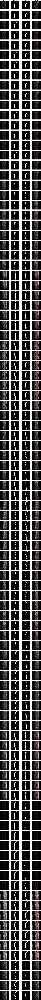

In [110]:
plot_imgs(org_imgs=X_test2, mask_imgs=y_test2, pred_imgs=y_pred2, nm_img_to_plot=100)

In [82]:
print(X_test2.shape)
print(y_test2.shape)
print(y_pred2.shape)

(235, 528, 528, 1)
(235, 528, 528, 1)
(235, 528, 528, 1)


In [85]:
# 3. Comparison between ROI_RAD (y_test2) and ROI_UNET (y_pred2): train with HC, validate with MD 
# X_train = HC, y_train = HC, X_test2 = MD, y_test2 = MD, y_pred2 = UNET model valided with X_test2 data  

DSC = []
JI = []
y_pred = y_pred2
y_test = y_test2

for n in range(y_pred.shape[0]):

    y_test_slice = y_test[n,:,:,:]
    y_pred_slice = y_pred[n,:,:,:]
    dsc = dice_coef2(y_test_slice, y_pred_slice)
    DSC.append(dsc)
    iou = dsc/(2 - dsc)
    JI.append(iou)
    print(n,dsc,iou)

0 0.8470621924071748 0.7346989463167347
1 0.8552185154084856 0.7470583049424914
2 0.8653632392760604 0.7626786556112699
3 0.8602848962878151 0.754824511393915
4 0.8749072891751204 0.7776312838554151
5 0.8802332102658049 0.7860861907457984
6 0.8795556207958598 0.7850060539556767
7 0.8718795682035311 0.7728603645757143
8 0.8670711361518295 0.7653359039743117
9 0.8470621924071748 0.7346989463167347
10 0.8552185154084856 0.7470583049424914
11 0.8653632392760604 0.7626786556112699
12 0.8602848962878151 0.754824511393915
13 0.8749072891751204 0.7776312838554151
14 0.8802332102658049 0.7860861907457984
15 0.8795556207958598 0.7850060539556767
16 0.8718795682035311 0.7728603645757143
17 0.8670711361518295 0.7653359039743117
18 0.7849637103892636 0.6460413710283041
19 0.8569858502180688 0.7497596161706029
20 0.8978701745155665 0.8146682484714666
21 0.9144564744077723 0.8423950333164971
22 0.9149884814591726 0.8432984035871717
23 0.9196637376607988 0.8512754498025404
24 0.9187448134915153 0.8497

225 0.9006716427229704 0.8192926496992037
226 0.836524088401872 0.7189870284919252
227 0.8785770285539497 0.7834483963005002
228 0.8819885594182808 0.7888904597965188
229 0.8886928575217755 0.79968248520385
230 0.8823644973107806 0.7894921870213167
231 0.8899579405641778 0.8017335316253674
232 0.8638935246018223 0.760398381057593
233 0.8552102637449214 0.7470457121170119
234 0.8749109168110895 0.7776370154897199


In [86]:
DSC = np.array(DSC)
JI = np.array(JI)

print(np.mean(DSC))
print(np.std(DSC))
print(np.mean(JI))
print(np.std(JI))

0.7381349830895184
0.22743296931685242
0.6253153005409384
0.22699338304729993


In [102]:
# 2. comparison between ROI_RAD_RESAMPLE_TEST vs. ROI_3DGC_RESAMPLE_TEST (delineated by a 3D Grow-cut algorithm)

# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [103]:
# feature for deep learning (3D): mask

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_RAD_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
mask = sitk.GetArrayFromImage(first)

mask_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    mask_reshape = np.dstack((mask_reshape, j_reshape))

In [104]:
# delete .DS_Store file in each folder 

# resample
            
resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_3DGC_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_seg = len(resampfile)
count_seg = 0
for item_resamp in os.listdir(resampath):
    current_resamp = os.path.basename(item_resamp)
    if current_resamp == '.DS_Store':
        fullpath = os.path.join(resampath,current_resamp)
        os.remove(fullpath)

In [105]:
# feature for deep learning (3D): mask (now feature)

resampath = '/Applications/anaconda3/envs/myenv/mywork/unet/data/ROI_3DGC_RESAMPLE_MD/Test/'
resampfile = os.listdir(resampath)
resampfile.sort()
num_img = len(resampfile)

first = sitk.ReadImage(os.path.join(resampath,resampfile[0]))
feature = sitk.GetArrayFromImage(first)

feature_reshape = mask.transpose(1,2,0)

for n in range(len(os.listdir(resampath))):

    i = sitk.ReadImage(os.path.join(resampath,resampfile[n]))
    j = sitk.GetArrayFromImage(i)
    j_reshape = j.transpose(1,2,0)
    feature_reshape = np.dstack((feature_reshape, j_reshape))

In [106]:
# Extract slices with masks identified from a test set 

mask_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))
feature_valid = np.zeros((feature_reshape.shape[0], feature_reshape.shape[1]))

for n in range(feature_reshape.shape[2]):

    mask_slice = mask_reshape[:,:,n]
    feature_slice = feature_reshape[:,:,n]
    
    if (len(np.unique(mask_slice)) > 1): # only if mask is identified by a radiologist 
        
        mask_valid = np.dstack((mask_valid, mask_slice))
        feature_valid = np.dstack((feature_valid, feature_slice))
        
mask_valid = mask_valid[:,:,1:]
feature_valid = feature_valid[:,:,1:]

print(mask_valid.shape)
print(feature_valid.shape)

(528, 528, 185)
(528, 528, 185)


In [107]:
feature = feature_valid
feature_temp = feature.transpose(2,0,1)
feature_final = feature_temp.reshape((feature_temp.shape[0],feature_temp.shape[1],feature_temp.shape[2],1))

mask = mask_valid
mask_final = mask.transpose(2,0,1)
mask_final = mask_final.reshape((mask_final.shape[0],mask_final.shape[1],mask_final.shape[2],1))

y_pred_3DGC = feature_final 

print(y_pred_3DGC.shape)
print(mask_final.shape)

(185, 528, 528, 1)
(185, 528, 528, 1)


In [108]:
DSC = []
JI = []

y_pred = y_pred_3DGC
y_test = mask_final 

for n in range(y_pred.shape[0]):

    y_test_slice = y_test[n,:,:,:]
    y_pred_slice = y_pred[n,:,:,:]
    dsc = dice_coef2(y_test_slice, y_pred_slice)
    DSC.append(dsc)
    iou = dsc/(2 - dsc)
    JI.append(iou)
    print(n,dsc,iou)

0 1.0 1.0
1 1.0 1.0
2 1.0 1.0
3 1.0 1.0
4 1.0 1.0
5 1.0 1.0
6 1.0 1.0
7 1.0 1.0
8 1.0 1.0
9 0.26474930942641817 0.15257121686487046
10 0.36138521644317395 0.22054311975554158
11 0.36825562399621864 0.2256821775590206
12 0.347523300469949 0.21030450872244152
13 0.34178204425367137 0.20611406544554184
14 0.33065750662733817 0.19807649295459626
15 0.3417109383092288 0.20606234835850903
16 0.3460499700120324 0.20922637548762577
17 0.29376237056648363 0.17216967056576693
18 0.31010734007569646 0.18350712292553972
19 0.33437958936850287 0.20075377753189722
20 0.31947059772959596 0.19010116532206428
21 0.320958147439983 0.19115553727896753
22 0.33703519820220024 0.2026712759270899
23 0.34281987739663494 0.20686941191285732
24 0.3542109906076488 0.21522260058014886
25 0.35458665416471324 0.21550004748789062
26 0.35631381672482876 0.2167772780171736
27 0.510343431025618 0.34259133390522745
28 0.5046850698458518 0.33751088795309836
29 0.4920985493006788 0.3263466250214546
30 0.48474003059879195 

In [109]:
DSC = np.array(DSC)
JI = np.array(JI)

print(np.mean(DSC))
print(np.std(DSC))
print(np.mean(JI))
print(np.std(JI))

0.4442608852432956
0.15955929900593332
0.30340860156352806
0.17734575513416034


In [ ]:
import numpy as np
from scipy.ndimage import morphology

def surfd(input1, input2, sampling=1, connectivity=1):
    
    input_1 = np.atleast_1d(input1.astype(np.bool))
    input_2 = np.atleast_1d(input2.astype(np.bool))
    

    conn = morphology.generate_binary_structure(input_1.ndim, connectivity)

    S = input_1 - morphology.binary_erosion(input_1, conn)
    Sprime = input_2 - morphology.binary_erosion(input_2, conn)

    
    dta = morphology.distance_transform_edt(~S,sampling)
    dtb = morphology.distance_transform_edt(~Sprime,sampling)
    
    sds = np.concatenate([np.ravel(dta[Sprime!=0]), np.ravel(dtb[S!=0])])
       
    
    return sds

In [ ]:
surface_distance = surfd(y_pred, y_test, [0.5303, 0.5303, 3],1)

In [ ]:
msd = surface_distance.mean()
rms = np.sqrt((surface_distance**2).mean())
hd  = surface_distance.max()

In [ ]:
# save U-Net segmented BM 

predpath = '/Users/hwang/research/1_MM/Data/2_benign_MM/U-Net/pred/'

mresampath = '/Users/hwang/research/1_MM/Data/2_benign_MM/U-Net/resample_mask2/test/'
mresampfile = os.listdir(mresampath)
mresampfile.sort()
num_img = len(mresampfile)

num = 0

for n in os.listdir(mresampath):

    numslice = 19
    fslice = num*numslice
    lslice = ((num+1)*numslice)-1
    image3 = image2[fslice:lslice,:,:]
    image4 = sitk.GetImageFromArray(image3)
    image4.SetSpacing([0.5303, 0.5303, 3])
    sitk.WriteImage(image4,os.path.join(predpath,mresampfile[num]),True)
    
    if num < num_img-1:
        num = num + 1